In [1]:
import os
import glob
import numpy as np
import pandas as pd
from PIL import Image


import tensorflow as tf
import matplotlib.pyplot as plt


from keras.models import *
from keras import backend as K
from keras.optimizers import Adam
from keras.utils.generic_utils import get_custom_objects
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, History, ReduceLROnPlateau, EarlyStopping
from keras.layers import Input, merge, Dropout, concatenate, Conv2D, MaxPooling2D, UpSampling2D, Activation, Conv2DTranspose, BatchNormalization, add, multiply


os.environ["CUDA_VISIBLE_DEVICES"]="1"

Using TensorFlow backend.


In [2]:
def dice_coef(y_true, y_pred, smooth=0.001):
    y_true_f = K.flatten(y_true)
    # y_true를 일렬로 정렬한다.
    y_pred_f = K.flatten(y_pred)
    # y_pred를 일렬로 정렬한다.
    intersection = K.sum(y_true_f * y_pred_f)
    # y_true_f와 y_pred_f, 두 이미지를 곱해서 교집합을 구한다.
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    # dice coefficient를 반환한다. -> 수식이 저럼.
    # +앞에 2. 에서 .은 float형으로 나타내기 위함.
    # +수식내에 smooth는 분모가 0이 되는 것을 방지함.

    
def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)
    # (dice coefficient loss) = 1 - (dice coefficient) 관계임.
    # dice coefficient loss는 낮을수록 좋음.


get_custom_objects().update({
    
    'dice_coef' : dice_coef,
    'dice_coef_loss' : dice_coef_loss,
       
})


In [3]:
img_path='../data/AW_img.npy'
label_path='../data/AW_label.npy'

image = np.load(img_path) / 255
label = np.load(label_path) / 255

print(image.shape)
print(label.shape)

(1360, 512, 512, 3)
(1360, 512, 512, 3)


In [4]:
# image = np.expand_dims(image, axis=3)
# # 3번째 axis에 차원을 추가한다.
# label = np.expand_dims(label, axis=3)
# # 3번째 axis에 차원을 추가한다.

In [5]:
print(image.shape)
print(label.shape)

(1360, 512, 512, 3)
(1360, 512, 512, 3)


In [6]:
tr_num=round(image.shape[0]*0.8)
val_num=round(image.shape[0]*0.8*0.8)

train_image = image[:val_num,:,:]
train_label = label[:val_num,:,:]

validation_image = image[val_num:tr_num,:,:]
validation_label = label[val_num:tr_num,:,:]

test_image = image[tr_num:,:,:]
test_label = label[tr_num:,:,:]

print('-'*30)
print(train_image.shape)
print(train_label.shape)
print('-'*30)
print(validation_image.shape)
print(validation_label.shape)
print('-'*30)
print(test_image.shape)
print(test_label.shape)

------------------------------
(870, 512, 512, 3)
(870, 512, 512, 3)
------------------------------
(218, 512, 512, 3)
(218, 512, 512, 3)
------------------------------
(272, 512, 512, 3)
(272, 512, 512, 3)


In [7]:
def Conv2D_block(input_layer, out_n_filters, kernel_size=[3,3], stride=[1,1], padding='same'):
    
    layer = input_layer
    
    for i in range(2):
        
        layer = Conv2D(out_n_filters, kernel_size, strides=stride, padding=padding)(layer)
        layer = BatchNormalization()(layer)
        layer = Activation('relu')(layer)        
        
    out_layer = layer
    
    return out_layer

def Up_and_Concate(down_layer, layer):
    
    input_channel = down_layer.get_shape().as_list()[3]
    output_channel = input_channel // 2
    
    up = UpSampling2D(size = (2,2))(down_layer)

    concate = concatenate([up, layer])
    return concate

In [8]:
def U_Net_2D(img_w, img_h, n_label):
        
    #inputs = Input((img_w, img_h, 1), dtype = 'float32')
    inputs = Input((img_w, img_h, 3), dtype = 'float32')
    x = inputs
    depth = 4
    features = 64
    down_layer = []
    
    
    for i in range(depth):
        
        x = Conv2D_block(x, features) 
        down_layer.append(x)
        x = MaxPooling2D(pool_size=[2, 2], strides=[2, 2])(x)

        features = features * 2
        
    x = Conv2D_block(x, features)
    
    for i in reversed(range(depth)):

        features = features // 2
        
        x = Up_and_Concate(x, down_layer[i])
        x = Conv2D_block(x, features)
        
    
    conv_last = Conv2D(n_label, kernel_size=[1, 1], padding='same')(x)
    conv_last = Activation('sigmoid')(conv_last)  
    
    outputs = conv_last
    
    model = Model(inputs = inputs, outputs = outputs)
    
    model.summary()
    
    return model

In [9]:
model = U_Net_2D(512,512,3)

W0830 10:22:40.373716 135440771533280 module_wrapper.py:139] From /root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:66: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0830 10:22:40.375715 135440771533280 module_wrapper.py:139] From /root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:541: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0830 10:22:40.379372 135440771533280 module_wrapper.py:139] From /root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4432: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0830 10:22:40.402992 135440771533280 module_wrapper.py:139] From /root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:190: The name tf.get_default_session is deprecated. Please use tf.comp

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 512, 512, 64) 0           batch_normalization_1[0][0]      
____________________________________________________________________________________________

In [12]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1, min_delta=1e-8)
earlystopper = EarlyStopping(monitor='val_loss', patience=30, verbose=1)
model_checkpoint = ModelCheckpoint('../result/model/unet_AW.h5', monitor='val_loss', verbose=1, save_best_only=True, save_weights_only=False)

callbacks_list = [reduce_lr, model_checkpoint, earlystopper]

model.compile(optimizer=Adam(lr=0.01), loss=dice_coef_loss, metrics=[dice_coef])

In [13]:
print('Fitting model...')
print('-'*200)
hist = model.fit(train_image, train_label, batch_size=1, epochs=200, verbose=1, validation_data = (validation_image, validation_label), shuffle=True, callbacks=callbacks_list)

Fitting model...
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Train on 870 samples, validate on 218 samples
Epoch 1/200
870/870 [==============================] - 122s 140ms/step - loss: 0.6066 - dice_coef: 0.3934 - val_loss: 0.8749 - val_dice_coef: 0.1251

Epoch 00001: val_loss improved from inf to 0.87492, saving model to ../result/model/unet_AW.h5
Epoch 2/200
870/870 [==============================] - 112s 128ms/step - loss: 0.5595 - dice_coef: 0.4405 - val_loss: 0.8272 - val_dice_coef: 0.1728

Epoch 00002: val_loss improved from 0.87492 to 0.82720, saving model to ../result/model/unet_AW.h5
Epoch 3/200
870/870 [==============================] - 112s 129ms/step - loss: 0.5290 - dice_coef: 0.4710 - val_loss: 0.8617 - val_dice_coef: 0.1383

Epoch 00003: val_loss did not improve from 0.82720
Epoch 4/200
870/870 [====================

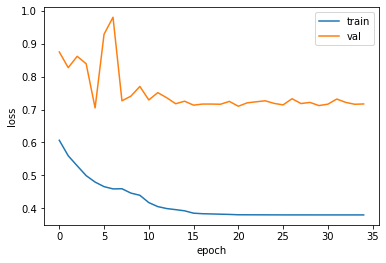

In [15]:
fig = plt.figure()
# plt.axes(facecolor='white')
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
# plt.title('%s, %d, %d'%(modelname, NUM, num_tr))
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper right')
# plt.rcParams['font.serif']='Times New Roman'
# plt.savefig('../result/model/manualgan/loss_test_%d_tr%d_dataRe4.png'%(NUM,num_tr))

# pred

In [16]:
print('predict test data')
print('-'*200)
predict_model = model.predict(test_image, batch_size=1, verbose=1)


def preds_Thresh(preds_test,Thresh_value):
    
    preds_mask = np.ndarray((test_image.shape[0], 512, 512, 3), dtype=np.float32)
  
    preds_mask0 = preds_test[:,:,:,0] > Thresh_value
  
    preds_mask[:,:,:,0] = preds_mask0*1
    
    return preds_mask

preds_imgs = preds_Thresh(predict_model, 0.5)
print(test_image.shape)
print(preds_imgs.shape)

predict test data
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
272/272 [==============================] - 12s 43ms/step
(272, 512, 512, 3)
(272, 512, 512, 3)


/root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


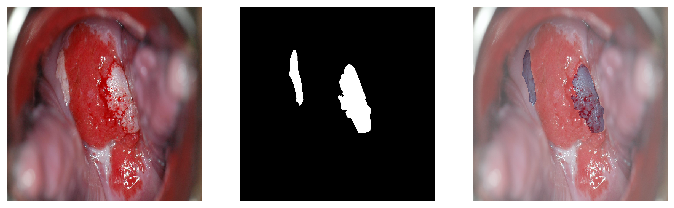

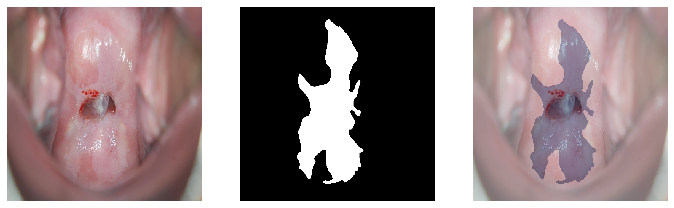

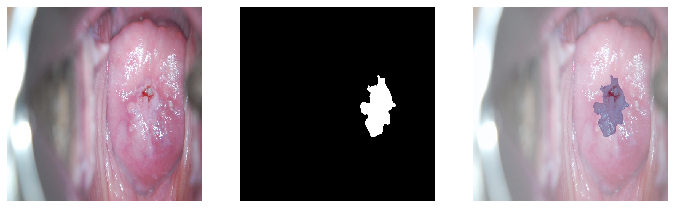

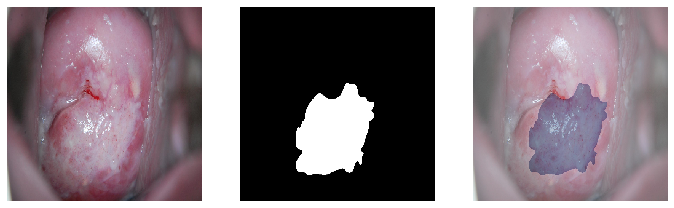

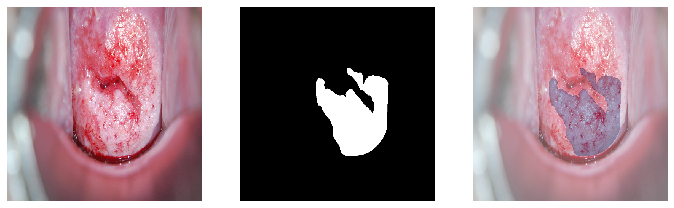

...

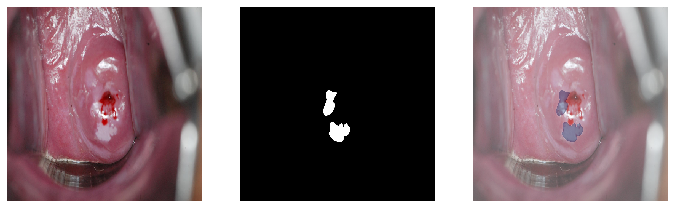

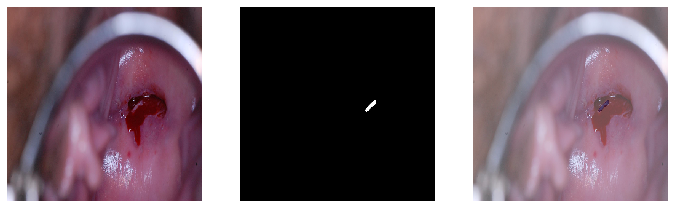

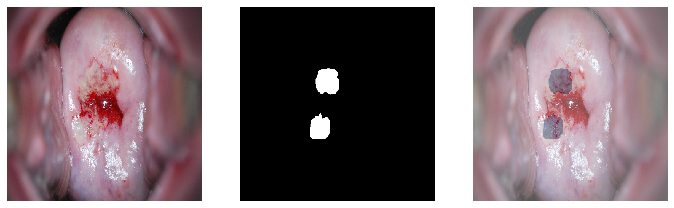

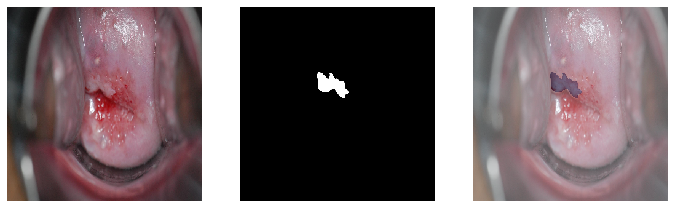

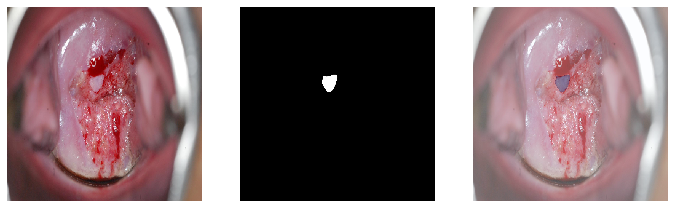

In [19]:
# cnt=test_image.shape[0]

# train_image_cp=np.zeros(train_image.shape)
# train_image_cp[:,:,:,0]=train_image[:,:,:,2]
# train_image_cp[:,:,:,1]=train_image[:,:,:,1]
# train_image_cp[:,:,:,2]=train_image[:,:,:,0]
# for i in range(50):
# #     img = cv2.cvtColor(test_image[i,:,:,:], cv2.COLOR_BGR2RGB)
#     plt.figure(figsize=(16, 16))
#     plt.subplot(1,4,1)
#     plt.imshow(train_image_cp[i,:,:,:])#,cmap='rgb')
#     plt.axis('off')
#     plt.subplot(1,4,2)
#     plt.imshow(train_label[i,:,:,0],cmap='gray')
#     plt.axis('off')
    
#     plt.subplot(1,4,3)
#     plt.imshow(train_image_cp[i,:,:,:])#,cmap='rgb')
#     plt.imshow(train_label[i,:,:,0],cmap='Blues',alpha=0.3)
#     plt.axis('off')

In [72]:

cnt=test_image.shape[0]

test_image_cp=np.zeros(test_image.shape)
test_image_cp[:,:,:,0]=test_image[:,:,:,2]
test_image_cp[:,:,:,1]=test_image[:,:,:,1]
test_image_cp[:,:,:,2]=test_image[:,:,:,0]


vol_new=np.zeros((272,960,1280,3))
vol_new_pred=np.zeros((272,960,1280,3))
vol_new_label=np.zeros((272,960,1280,3))
for i in range(cnt):
    vol_new[i,:,:,:]=cv2.resize(test_image_cp[i,:,:,:],(1280,960))
    vol_new_pred[i,:,:,:]=cv2.resize(preds_imgs[i,:,:,:],(1280,960))
    vol_new_label[i,:,:,:]=cv2.resize(test_label[i,:,:,:],(1280,960))
    

/root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


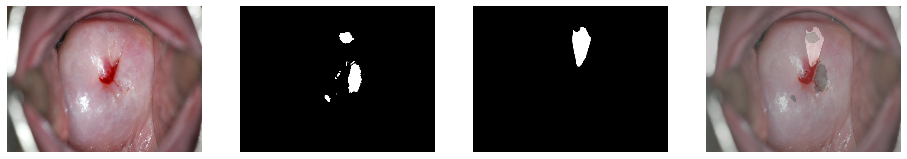

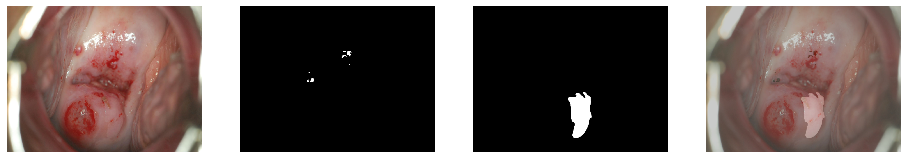

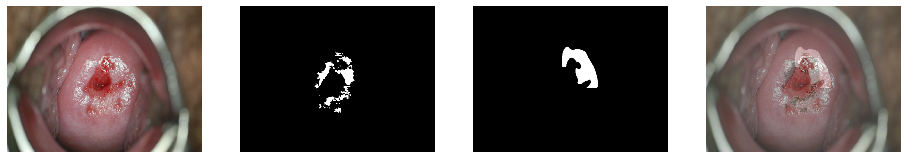

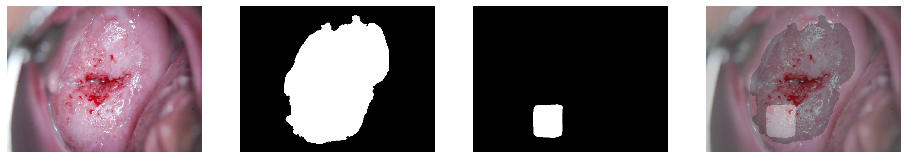

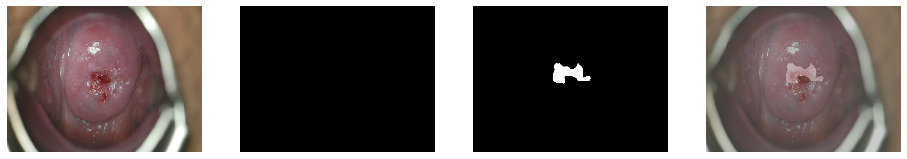

...

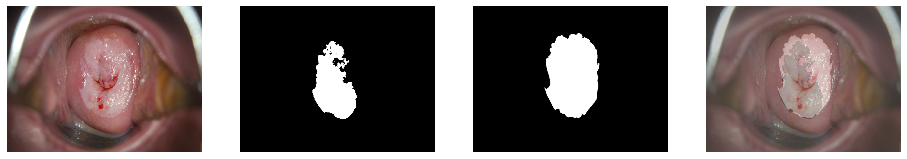

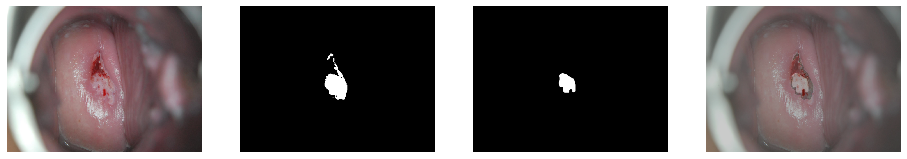

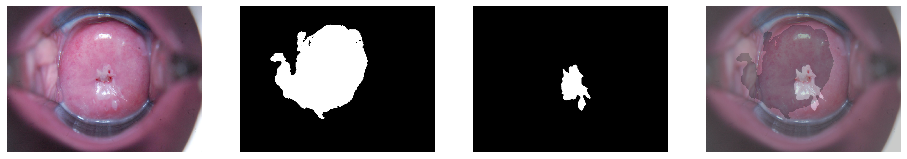

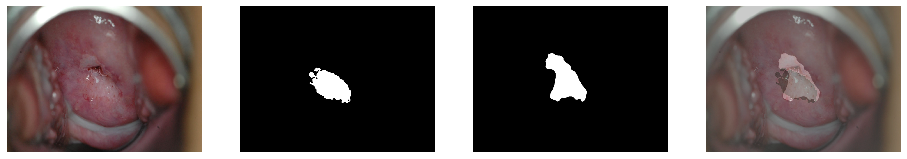

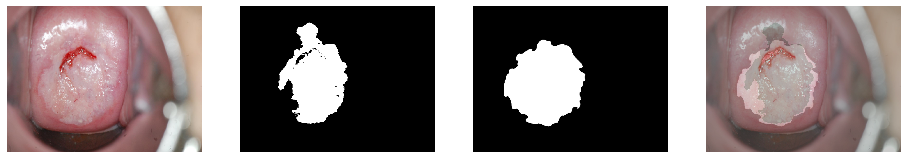

In [73]:
for i in range(cnt):
    print()
    img1=vol_new[i,:,:,:]
    img2=vol_new_pred[i,:,:,0]
    img3=vol_new_label[i,:,:,:]
    
    plt.figure(figsize=(16, 16))
    plt.subplot(1,4,1)
    plt.imshow(img1)#,cmap='rgb')
    plt.axis('off')
    plt.subplot(1,4,2)
    plt.imshow(img2,cmap='gray')
    plt.axis('off')
    plt.subplot(1,4,3)
    plt.imshow(img3,cmap='gray')
    plt.axis('off')
    
    plt.subplot(1,4,4)
    plt.imshow(img1)#,cmap='rgb')
    plt.imshow(img2,cmap='Greens', alpha=0.2)
    plt.imshow(img3,cmap='Blues',alpha=0.2)
    plt.axis('off')
    
    del img1,img2,img3
    
del vol_new, vol_new_pred, vol_new_label, test_image_cp

0 ============================
tp fp | 1141 3197
fn tn | 3039 254147
recall= 0.273
precision= 0.263
dice= 0.268
IoU= 0.1543978349120433


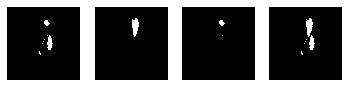

1 ============================
tp fp | 0 405
fn tn | 6248 254637
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


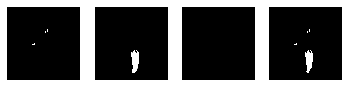

2 ============================
tp fp | 1914 3162
fn tn | 4236 251731
recall= 0.311
precision= 0.377
dice= 0.341
IoU= 0.20077625091786427


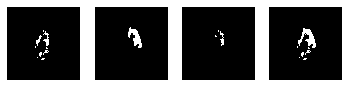

3 ============================
tp fp | 8351 78532
fn tn | 0 174803
recall= 1.0
precision= 0.096
dice= 0.175
IoU= 0.09561483856194183


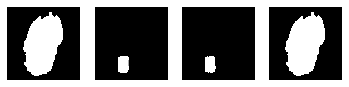

4 ============================
tp fp | 0 0
fn tn | 3689 257741
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


/root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in long_scalars


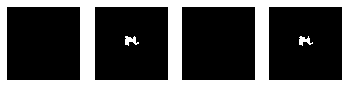

5 ============================
tp fp | 8295 17404
fn tn | 752 234571
recall= 0.917
precision= 0.323
dice= 0.477
IoU= 0.302108751866555


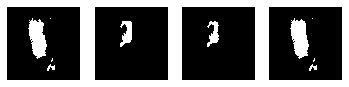

6 ============================
tp fp | 4287 21710
fn tn | 2118 232776
recall= 0.669
precision= 0.165
dice= 0.265
IoU= 0.1492636050276801


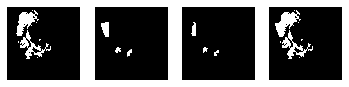

7 ============================
tp fp | 6310 13150
fn tn | 302 241536
recall= 0.954
precision= 0.324
dice= 0.484
IoU= 0.31030243422670273


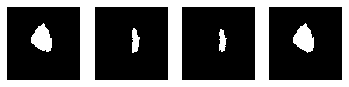

8 ============================
tp fp | 0 129
fn tn | 512 261254
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


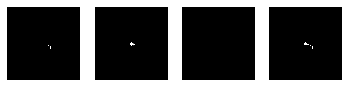

9 ============================
tp fp | 0 0
fn tn | 24164 236692
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


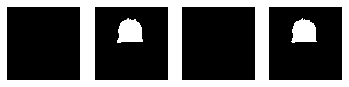

10 ============================
tp fp | 9996 19688
fn tn | 1396 230235
recall= 0.877
precision= 0.337
dice= 0.487
IoU= 0.31591921873518536


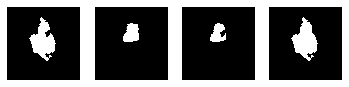

11 ============================
tp fp | 48874 4165
fn tn | 10950 196233
recall= 0.817
precision= 0.921
dice= 0.866
IoU= 0.7573958995180462


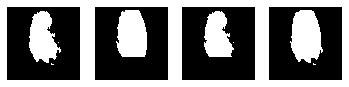

12 ============================
tp fp | 1325 57445
fn tn | 0 203009
recall= 1.0
precision= 0.023
dice= 0.044
IoU= 0.02240635833262873


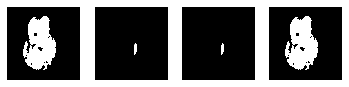

13 ============================
tp fp | 424 7
fn tn | 8663 252028
recall= 0.047
precision= 0.984
dice= 0.089
IoU= 0.046608772122677805


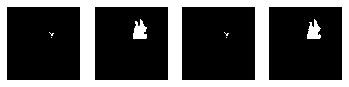

14 ============================
tp fp | 7196 9977
fn tn | 7143 237052
recall= 0.502
precision= 0.419
dice= 0.457
IoU= 0.29277025102729975


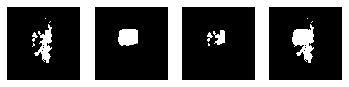

15 ============================
tp fp | 0 0
fn tn | 1189 260622
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


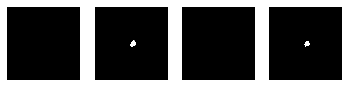

16 ============================
tp fp | 0 0
fn tn | 1414 260210
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


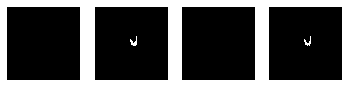

17 ============================
tp fp | 0 29
fn tn | 4956 256613
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


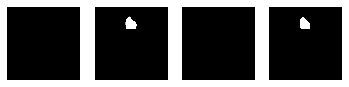

18 ============================
tp fp | 8285 20993
fn tn | 19813 211532
recall= 0.295
precision= 0.283
dice= 0.289
IoU= 0.16767860756931796


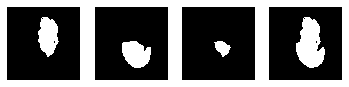

19 ============================
tp fp | 4714 6
fn tn | 4424 252174
recall= 0.516
precision= 0.999
dice= 0.68
IoU= 0.5145726449077611


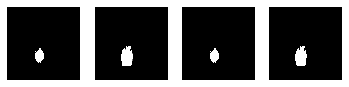

20 ============================
tp fp | 354 33084
fn tn | 54 228243
recall= 0.868
precision= 0.011
dice= 0.021
IoU= 0.010479263491311685


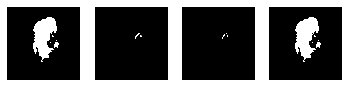

21 ============================
tp fp | 2137 24778
fn tn | 1 234737
recall= 1.0
precision= 0.079
dice= 0.147
IoU= 0.077992700729927


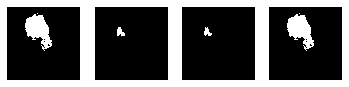

22 ============================
tp fp | 2149 11565
fn tn | 0 247931
recall= 1.0
precision= 0.157
dice= 0.271
IoU= 0.15130606209955644


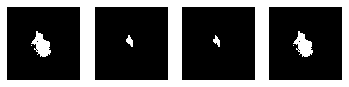

23 ============================
tp fp | 45335 5871
fn tn | 3383 206063
recall= 0.931
precision= 0.885
dice= 0.907
IoU= 0.8243626577444813


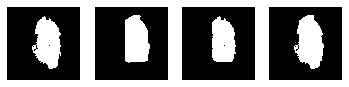

24 ============================
tp fp | 2176 662
fn tn | 8272 250346
recall= 0.208
precision= 0.767
dice= 0.328
IoU= 0.19547251167804527


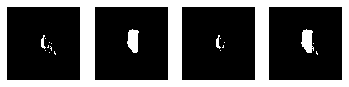

25 ============================
tp fp | 1578 15557
fn tn | 7836 236063
recall= 0.168
precision= 0.092
dice= 0.119
IoU= 0.06269866497139225


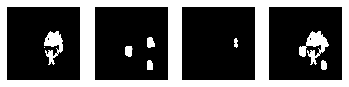

26 ============================
tp fp | 0 0
fn tn | 4185 257251
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


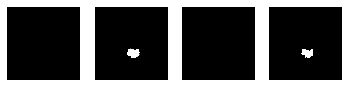

27 ============================
tp fp | 6537 101089
fn tn | 0 153677
recall= 1.0
precision= 0.061
dice= 0.115
IoU= 0.060267178035715935


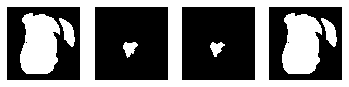

28 ============================
tp fp | 6418 12930
fn tn | 7917 234096
recall= 0.448
precision= 0.332
dice= 0.381
IoU= 0.23460174726760974


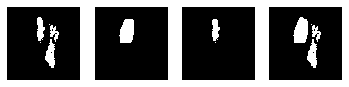

29 ============================
tp fp | 8280 415
fn tn | 4350 248091
recall= 0.656
precision= 0.952
dice= 0.777
IoU= 0.626608142878765


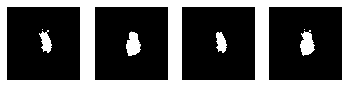

30 ============================
tp fp | 458 1042
fn tn | 5116 254941
recall= 0.082
precision= 0.305
dice= 0.129
IoU= 0.06849110213847764


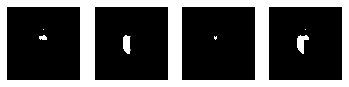

31 ============================
tp fp | 0 0
fn tn | 4387 257080
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


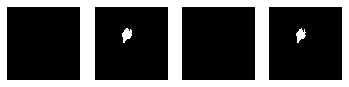

32 ============================
tp fp | 221 205
fn tn | 44 261530
recall= 0.834
precision= 0.519
dice= 0.64
IoU= 0.4185606060606061


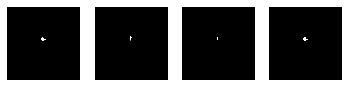

33 ============================
tp fp | 4743 23608
fn tn | 1474 231304
recall= 0.763
precision= 0.167
dice= 0.274
IoU= 0.15565108952480966


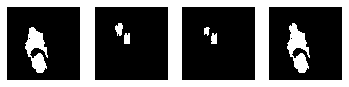

34 ============================
tp fp | 4154 16821
fn tn | 11 239887
recall= 0.997
precision= 0.198
dice= 0.33
IoU= 0.18731117824773413


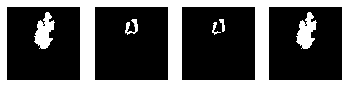

35 ============================
tp fp | 604 10
fn tn | 1372 259784
recall= 0.306
precision= 0.984
dice= 0.466
IoU= 0.299009900990099


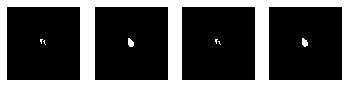

36 ============================
tp fp | 4233 10010
fn tn | 0 246666
recall= 1.0
precision= 0.297
dice= 0.458
IoU= 0.2738565051433008


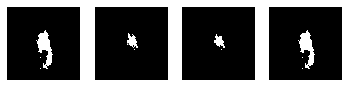

37 ============================
tp fp | 4103 8113
fn tn | 1703 247289
recall= 0.707
precision= 0.336
dice= 0.455
IoU= 0.2875262789067975


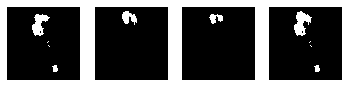

38 ============================
tp fp | 0 0
fn tn | 1594 259987
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


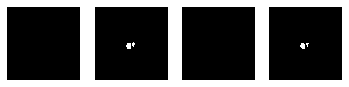

39 ============================
tp fp | 1449 312
fn tn | 5425 254240
recall= 0.211
precision= 0.823
dice= 0.336
IoU= 0.19986206896551725


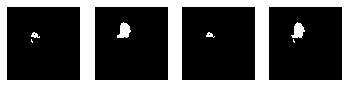

40 ============================
tp fp | 2269 1992
fn tn | 5869 251105
recall= 0.279
precision= 0.533
dice= 0.366
IoU= 0.22352477588414935


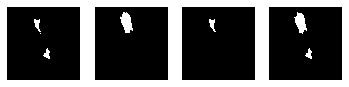

41 ============================
tp fp | 3386 18869
fn tn | 0 239481
recall= 1.0
precision= 0.152
dice= 0.264
IoU= 0.149406521643207


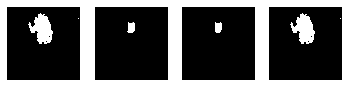

42 ============================
tp fp | 10506 45475
fn tn | 53 205189
recall= 0.995
precision= 0.188
dice= 0.316
IoU= 0.18477935874210738


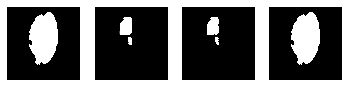

43 ============================
tp fp | 1722 2992
fn tn | 2779 253954
recall= 0.383
precision= 0.365
dice= 0.374
IoU= 0.22911122937732836


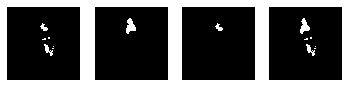

44 ============================
tp fp | 3236 738
fn tn | 11284 246151
recall= 0.223
precision= 0.814
dice= 0.35
IoU= 0.21125473299386344


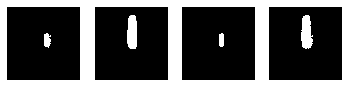

45 ============================
tp fp | 161 248
fn tn | 1174 260103
recall= 0.121
precision= 0.394
dice= 0.185
IoU= 0.09847094801223241


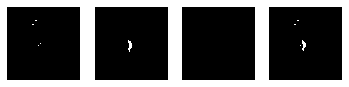

46 ============================
tp fp | 2193 36
fn tn | 4263 254675
recall= 0.34
precision= 0.984
dice= 0.505
IoU= 0.3364012885411873


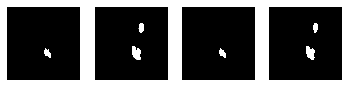

47 ============================
tp fp | 27306 32733
fn tn | 167 199741
recall= 0.994
precision= 0.455
dice= 0.624
IoU= 0.439788046191757


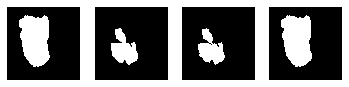

48 ============================
tp fp | 1094 1068
fn tn | 628 258914
recall= 0.635
precision= 0.506
dice= 0.563
IoU= 0.3822501747030049


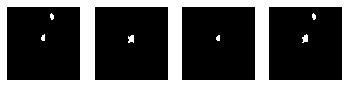

49 ============================
tp fp | 0 0
fn tn | 27224 232628
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


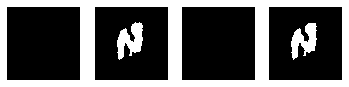

50 ============================
tp fp | 0 2301
fn tn | 2351 256761
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


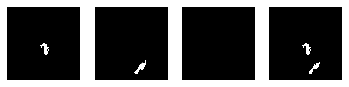

51 ============================
tp fp | 307 0
fn tn | 8207 252153
recall= 0.036
precision= 1.0
dice= 0.07
IoU= 0.0360540223135643


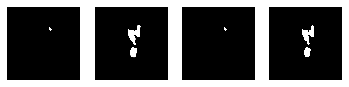

52 ============================
tp fp | 0 0
fn tn | 11063 250314
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


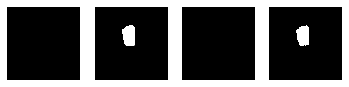

53 ============================
tp fp | 6975 61779
fn tn | 0 192199
recall= 1.0
precision= 0.101
dice= 0.184
IoU= 0.0997212095217671


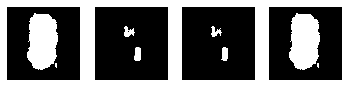

54 ============================
tp fp | 38624 1941
fn tn | 6014 213702
recall= 0.865
precision= 0.952
dice= 0.907
IoU= 0.8187213837544515


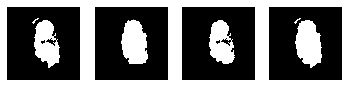

55 ============================
tp fp | 117 1594
fn tn | 711 259331
recall= 0.141
precision= 0.068
dice= 0.092
IoU= 0.04710144927536232


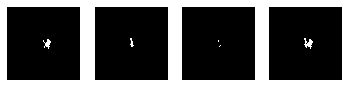

56 ============================
tp fp | 0 0
fn tn | 1823 259787
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


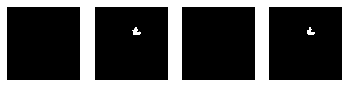

57 ============================
tp fp | 19888 17446
fn tn | 4961 218927
recall= 0.8
precision= 0.533
dice= 0.64
IoU= 0.4649010028284906


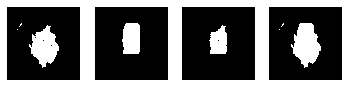

58 ============================
tp fp | 5979 4485
fn tn | 14 251030
recall= 0.998
precision= 0.571
dice= 0.727
IoU= 0.5418214771182601


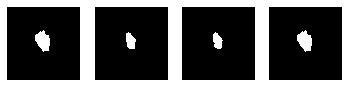

59 ============================
tp fp | 0 0
fn tn | 1640 260054
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


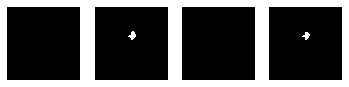

60 ============================
tp fp | 2993 170
fn tn | 4919 253316
recall= 0.378
precision= 0.946
dice= 0.54
IoU= 0.3674647022713321


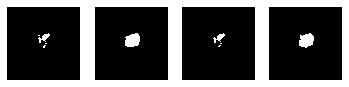

61 ============================
tp fp | 164 120
fn tn | 4108 257150
recall= 0.038
precision= 0.577
dice= 0.072
IoU= 0.037340619307832425


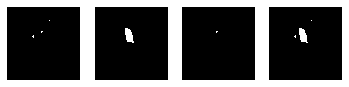

62 ============================
tp fp | 0 0
fn tn | 691 261128
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


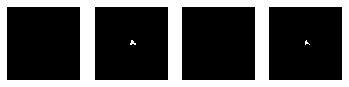

63 ============================
tp fp | 1497 4694
fn tn | 202 255266
recall= 0.881
precision= 0.242
dice= 0.379
IoU= 0.22376681614349775


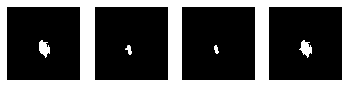

64 ============================
tp fp | 0 0
fn tn | 1923 259747
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


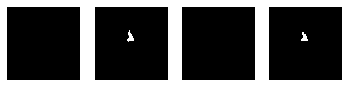

65 ============================
tp fp | 626 12
fn tn | 695 260425
recall= 0.474
precision= 0.981
dice= 0.639
IoU= 0.4556040756914119


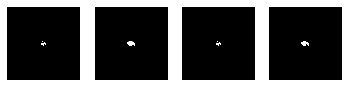

66 ============================
tp fp | 6265 17799
fn tn | 73 237226
recall= 0.988
precision= 0.26
dice= 0.412
IoU= 0.2523665659617321


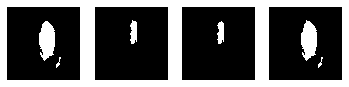

67 ============================
tp fp | 89 0
fn tn | 4491 257088
recall= 0.019
precision= 1.0
dice= 0.038
IoU= 0.01943231441048035


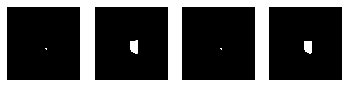

68 ============================
tp fp | 19547 0
fn tn | 14166 226877
recall= 0.58
precision= 1.0
dice= 0.734
IoU= 0.5797544192668169


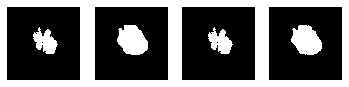

69 ============================
tp fp | 0 0
fn tn | 5305 255907
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


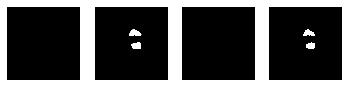

70 ============================
tp fp | 5482 22638
fn tn | 3993 229283
recall= 0.579
precision= 0.195
dice= 0.292
IoU= 0.16968458847927695


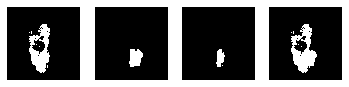

71 ============================
tp fp | 5173 38813
fn tn | 0 217021
recall= 1.0
precision= 0.118
dice= 0.21
IoU= 0.11471338285841003


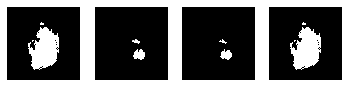

72 ============================
tp fp | 0 0
fn tn | 3548 258063
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


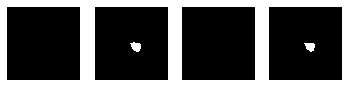

73 ============================
tp fp | 0 0
fn tn | 4544 256967
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


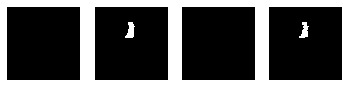

74 ============================
tp fp | 0 0
fn tn | 4238 257275
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


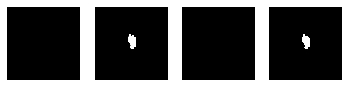

75 ============================
tp fp | 8738 38125
fn tn | 76 214246
recall= 0.991
precision= 0.186
dice= 0.314
IoU= 0.1829756046487279


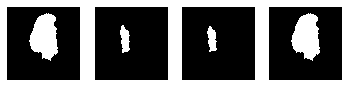

76 ============================
tp fp | 0 0
fn tn | 665 261084
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


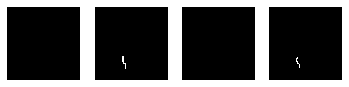

77 ============================
tp fp | 0 16997
fn tn | 0 245147
recall= nan
precision= 0.0
dice= 0.0
IoU= 0.0


/root/anaconda3/envs/powerai_162/lib/python3.6/site-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in long_scalars


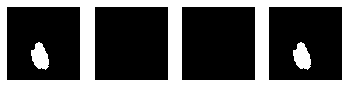

78 ============================
tp fp | 2426 7567
fn tn | 4533 246321
recall= 0.349
precision= 0.243
dice= 0.286
IoU= 0.16346607371470925


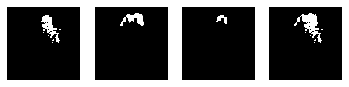

79 ============================
tp fp | 3099 1248
fn tn | 14974 241297
recall= 0.171
precision= 0.713
dice= 0.276
IoU= 0.15974226804123712


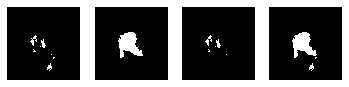

80 ============================
tp fp | 16532 25916
fn tn | 732 217909
recall= 0.958
precision= 0.389
dice= 0.554
IoU= 0.37496030845996825


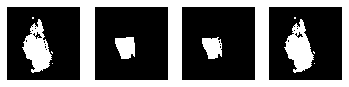

81 ============================
tp fp | 11836 5515
fn tn | 9828 233745
recall= 0.546
precision= 0.682
dice= 0.607
IoU= 0.4293072179905695


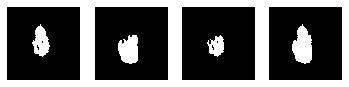

82 ============================
tp fp | 10683 16068
fn tn | 2659 230143
recall= 0.801
precision= 0.399
dice= 0.533
IoU= 0.3480144639541323


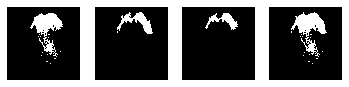

83 ============================
tp fp | 5715 35317
fn tn | 3787 215785
recall= 0.601
precision= 0.139
dice= 0.226
IoU= 0.12527674872311975


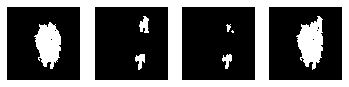

84 ============================
tp fp | 1515 6
fn tn | 9139 250248
recall= 0.142
precision= 0.996
dice= 0.249
IoU= 0.14107458795046093


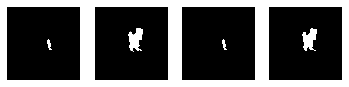

85 ============================
tp fp | 5231 7594
fn tn | 7716 240763
recall= 0.404
precision= 0.408
dice= 0.406
IoU= 0.2514057769020041


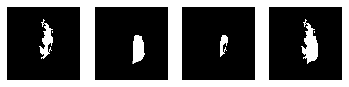

86 ============================
tp fp | 94 0
fn tn | 1294 260401
recall= 0.068
precision= 1.0
dice= 0.127
IoU= 0.06772334293948126


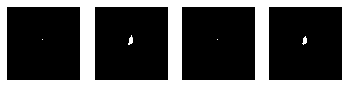

87 ============================
tp fp | 11517 11577
fn tn | 4025 233899
recall= 0.741
precision= 0.499
dice= 0.596
IoU= 0.4197616357473485


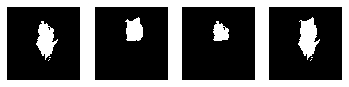

88 ============================
tp fp | 321 1222
fn tn | 1516 258746
recall= 0.175
precision= 0.208
dice= 0.19
IoU= 0.10161443494776828


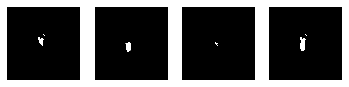

89 ============================
tp fp | 2440 20318
fn tn | 0 238988
recall= 1.0
precision= 0.107
dice= 0.194
IoU= 0.10542689249913585


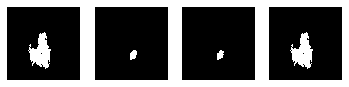

90 ============================
tp fp | 0 0
fn tn | 2715 258898
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


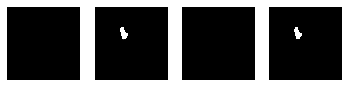

91 ============================
tp fp | 0 4065
fn tn | 3101 254502
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


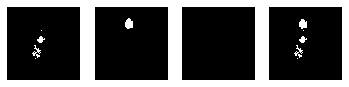

92 ============================
tp fp | 4736 3
fn tn | 10472 245416
recall= 0.311
precision= 0.999
dice= 0.475
IoU= 0.3110264661456623


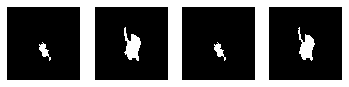

93 ============================
tp fp | 1594 11936
fn tn | 0 248310
recall= 1.0
precision= 0.118
dice= 0.211
IoU= 0.11524002313475998


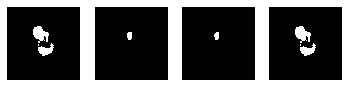

94 ============================
tp fp | 8913 18117
fn tn | 5474 228457
recall= 0.62
precision= 0.33
dice= 0.43
IoU= 0.27087892049598833


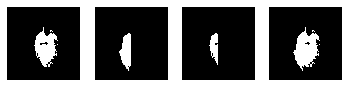

95 ============================
tp fp | 859 2897
fn tn | 291 257697
recall= 0.747
precision= 0.229
dice= 0.35
IoU= 0.20403800475059383


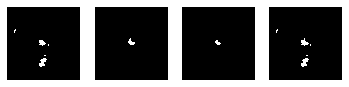

96 ============================
tp fp | 1887 30699
fn tn | 0 229081
recall= 1.0
precision= 0.058
dice= 0.109
IoU= 0.057072860901914525


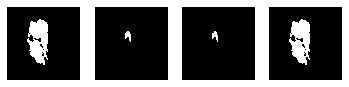

97 ============================
tp fp | 8495 34490
fn tn | 0 217993
recall= 1.0
precision= 0.198
dice= 0.33
IoU= 0.19240787298135942


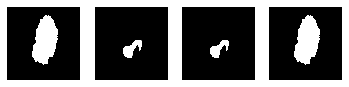

98 ============================
tp fp | 14379 5025
fn tn | 2077 239343
recall= 0.874
precision= 0.741
dice= 0.802
IoU= 0.647936193222783


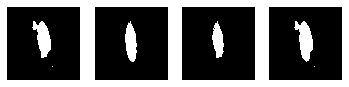

99 ============================
tp fp | 7450 14647
fn tn | 3488 235647
recall= 0.681
precision= 0.337
dice= 0.451
IoU= 0.2877558903051371


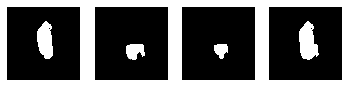

100 ============================
tp fp | 0 0
fn tn | 1724 260010
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


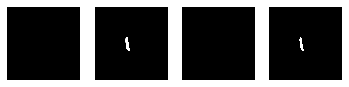

101 ============================
tp fp | 6236 16090
fn tn | 166 239150
recall= 0.974
precision= 0.279
dice= 0.434
IoU= 0.2728386419320966


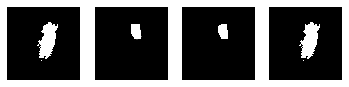

102 ============================
tp fp | 259 1
fn tn | 5400 255541
recall= 0.046
precision= 0.996
dice= 0.088
IoU= 0.04573547589616811


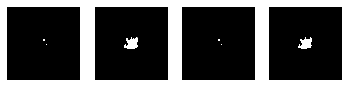

103 ============================
tp fp | 10169 9161
fn tn | 192 241657
recall= 0.981
precision= 0.526
dice= 0.685
IoU= 0.4972129865049873


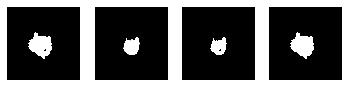

104 ============================
tp fp | 6843 6837
fn tn | 1105 246636
recall= 0.861
precision= 0.5
dice= 0.633
IoU= 0.44461048664804104


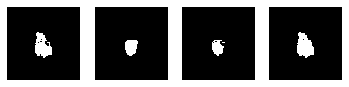

105 ============================
tp fp | 15 2596
fn tn | 12841 244882
recall= 0.001
precision= 0.006
dice= 0.002
IoU= 0.0009692426983716723


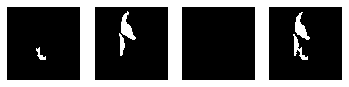

106 ============================
tp fp | 1411 4411
fn tn | 14512 240688
recall= 0.089
precision= 0.242
dice= 0.13
IoU= 0.06910569105691057


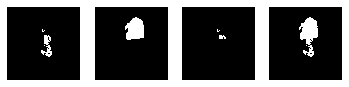

107 ============================
tp fp | 0 0
fn tn | 11343 250025
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


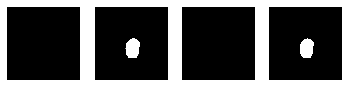

108 ============================
tp fp | 723 220
fn tn | 293 260488
recall= 0.712
precision= 0.767
dice= 0.738
IoU= 0.5193965517241379


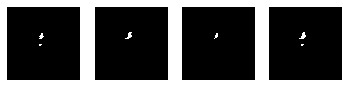

109 ============================
tp fp | 4278 9259
fn tn | 679 247588
recall= 0.863
precision= 0.316
dice= 0.463
IoU= 0.2961988506542962


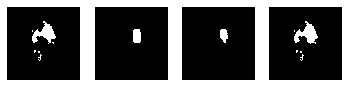

110 ============================
tp fp | 0 1209
fn tn | 1241 259361
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


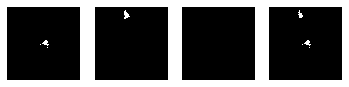

111 ============================
tp fp | 964 26481
fn tn | 34 234337
recall= 0.966
precision= 0.035
dice= 0.068
IoU= 0.03479139598671864


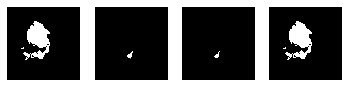

112 ============================
tp fp | 2003 11223
fn tn | 0 248389
recall= 1.0
precision= 0.151
dice= 0.263
IoU= 0.1457151171249818


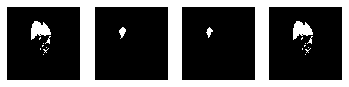

113 ============================
tp fp | 30198 4352
fn tn | 7750 217945
recall= 0.796
precision= 0.874
dice= 0.833
IoU= 0.7027530194782527


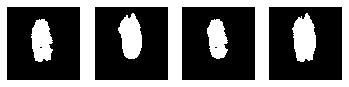

114 ============================
tp fp | 2765 1033
fn tn | 42767 213126
recall= 0.061
precision= 0.728
dice= 0.112
IoU= 0.059318215948340594


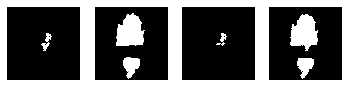

115 ============================
tp fp | 0 0
fn tn | 418 261392
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


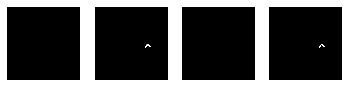

116 ============================
tp fp | 3765 38891
fn tn | 0 218833
recall= 1.0
precision= 0.088
dice= 0.162
IoU= 0.08692941746900326


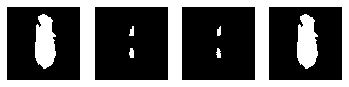

117 ============================
tp fp | 6049 2576
fn tn | 669 252369
recall= 0.9
precision= 0.701
dice= 0.789
IoU= 0.6316833751044277


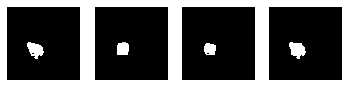

118 ============================
tp fp | 0 0
fn tn | 2983 258476
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


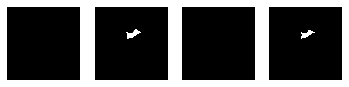

119 ============================
tp fp | 6925 8357
fn tn | 294 245766
recall= 0.959
precision= 0.453
dice= 0.616
IoU= 0.4290848255777929


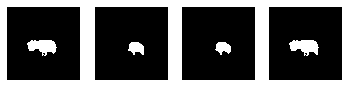

120 ============================
tp fp | 11035 1367
fn tn | 1065 247558
recall= 0.912
precision= 0.89
dice= 0.901
IoU= 0.7859126842817463


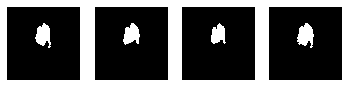

121 ============================
tp fp | 659 7771
fn tn | 396 253011
recall= 0.625
precision= 0.078
dice= 0.139
IoU= 0.07359839178020997


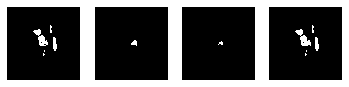

122 ============================
tp fp | 6073 6918
fn tn | 5611 242697
recall= 0.52
precision= 0.467
dice= 0.492
IoU= 0.32275722789115646


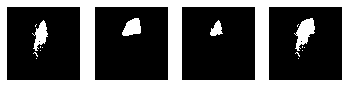

123 ============================
tp fp | 186 7146
fn tn | 4994 249144
recall= 0.036
precision= 0.025
dice= 0.03
IoU= 0.015020592748122426


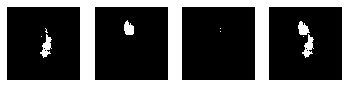

124 ============================
tp fp | 3628 135
fn tn | 10352 246955
recall= 0.26
precision= 0.964
dice= 0.409
IoU= 0.2564501307697745


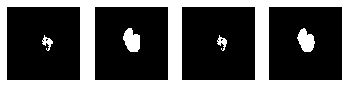

125 ============================
tp fp | 45628 20559
fn tn | 6698 187363
recall= 0.872
precision= 0.689
dice= 0.77
IoU= 0.617763336041159


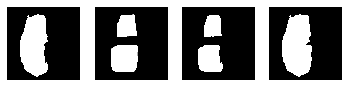

126 ============================
tp fp | 0 20005
fn tn | 1442 240241
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


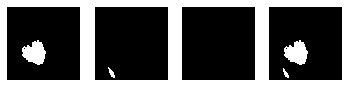

127 ============================
tp fp | 0 203
fn tn | 13962 245937
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


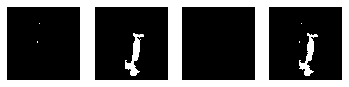

128 ============================
tp fp | 3487 1236
fn tn | 2341 254490
recall= 0.598
precision= 0.738
dice= 0.661
IoU= 0.48457476375764313


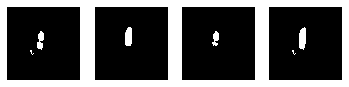

129 ============================
tp fp | 446 12832
fn tn | 441 248119
recall= 0.503
precision= 0.034
dice= 0.063
IoU= 0.03227440480497865


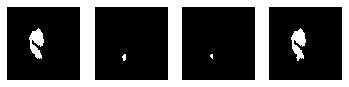

130 ============================
tp fp | 0 0
fn tn | 41085 219516
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


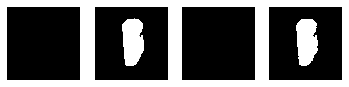

131 ============================
tp fp | 154 1730
fn tn | 20984 237714
recall= 0.007
precision= 0.082
dice= 0.013
IoU= 0.006726653271599546


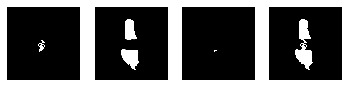

132 ============================
tp fp | 0 0
fn tn | 7497 253907
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


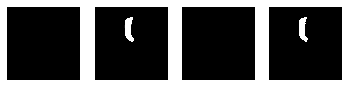

133 ============================
tp fp | 143 1
fn tn | 4429 256815
recall= 0.031
precision= 0.993
dice= 0.061
IoU= 0.0312568306010929


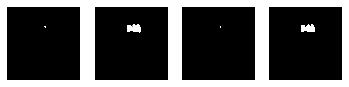

134 ============================
tp fp | 470 37788
fn tn | 0 223666
recall= 1.0
precision= 0.012
dice= 0.024
IoU= 0.012214772077550808


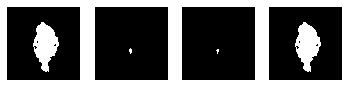

135 ============================
tp fp | 7116 43
fn tn | 4471 249800
recall= 0.614
precision= 0.994
dice= 0.759
IoU= 0.6108154506437768


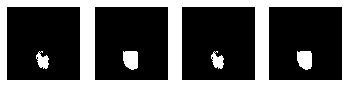

136 ============================
tp fp | 0 0
fn tn | 695 261203
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


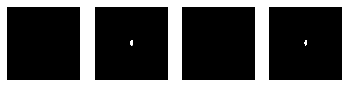

137 ============================
tp fp | 13493 8251
fn tn | 6981 232445
recall= 0.659
precision= 0.621
dice= 0.639
IoU= 0.4657898370615852


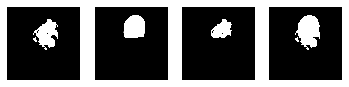

138 ============================
tp fp | 10045 97
fn tn | 15602 235583
recall= 0.392
precision= 0.99
dice= 0.561
IoU= 0.3901122373684415


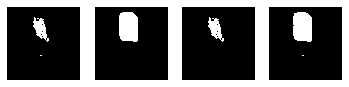

139 ============================
tp fp | 36 462
fn tn | 8135 252325
recall= 0.004
precision= 0.072
dice= 0.008
IoU= 0.004155604294124437


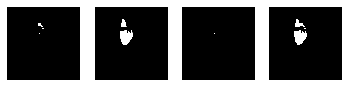

140 ============================
tp fp | 0 0
fn tn | 2978 258625
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


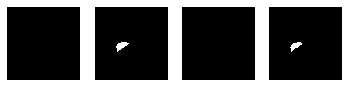

141 ============================
tp fp | 29173 26949
fn tn | 4795 199041
recall= 0.859
precision= 0.52
dice= 0.648
IoU= 0.46761344510875663


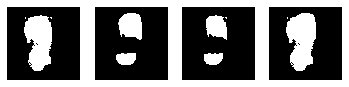

142 ============================
tp fp | 18385 14520
fn tn | 233 227588
recall= 0.987
precision= 0.559
dice= 0.714
IoU= 0.5337649518058297


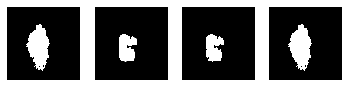

143 ============================
tp fp | 15319 20038
fn tn | 2 225937
recall= 1.0
precision= 0.433
dice= 0.605
IoU= 0.4233873196617102


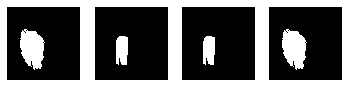

144 ============================
tp fp | 8523 4885
fn tn | 11481 235883
recall= 0.426
precision= 0.636
dice= 0.51
IoU= 0.33836198340545476


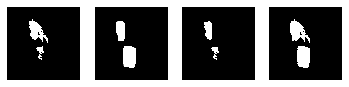

145 ============================
tp fp | 4097 69
fn tn | 19282 237261
recall= 0.175
precision= 0.983
dice= 0.297
IoU= 0.17451865735218947


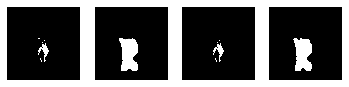

146 ============================
tp fp | 8 871
fn tn | 17406 242895
recall= 0.0
precision= 0.009
dice= 0.001
IoU= 0.0004375170905113481


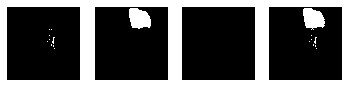

147 ============================
tp fp | 0 0
fn tn | 17629 243064
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


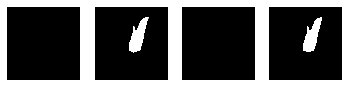

148 ============================
tp fp | 0 0
fn tn | 8543 253130
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


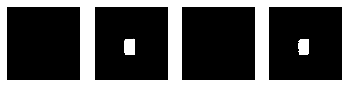

149 ============================
tp fp | 6 2006
fn tn | 12603 246749
recall= 0.0
precision= 0.003
dice= 0.001
IoU= 0.0004101161995898838


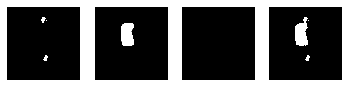

150 ============================
tp fp | 1781 18864
fn tn | 744 240127
recall= 0.705
precision= 0.086
dice= 0.154
IoU= 0.08232031430552346


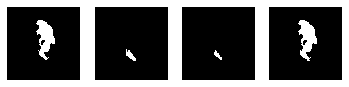

151 ============================
tp fp | 3832 13666
fn tn | 925 242888
recall= 0.806
precision= 0.219
dice= 0.344
IoU= 0.2011865385625033


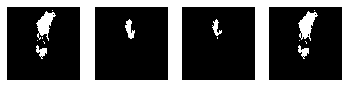

152 ============================
tp fp | 12518 12471
fn tn | 1364 234963
recall= 0.902
precision= 0.501
dice= 0.644
IoU= 0.46583804703780884


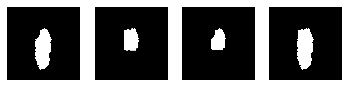

153 ============================
tp fp | 4419 0
fn tn | 12405 244277
recall= 0.263
precision= 1.0
dice= 0.416
IoU= 0.262660485021398


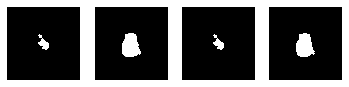

154 ============================
tp fp | 4834 6702
fn tn | 1243 248168
recall= 0.795
precision= 0.419
dice= 0.549
IoU= 0.3542170440389829


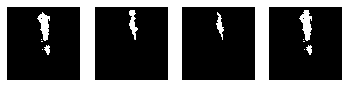

155 ============================
tp fp | 2733 1828
fn tn | 76 256987
recall= 0.973
precision= 0.599
dice= 0.742
IoU= 0.5399051758198341


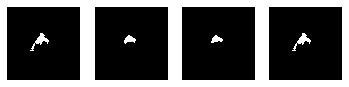

156 ============================
tp fp | 0 0
fn tn | 11653 249579
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


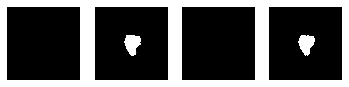

157 ============================
tp fp | 31250 6459
fn tn | 1970 220815
recall= 0.941
precision= 0.829
dice= 0.881
IoU= 0.7672477289467223


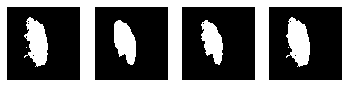

158 ============================
tp fp | 0 0
fn tn | 237 261682
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


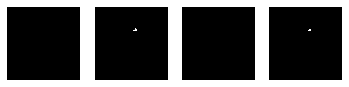

159 ============================
tp fp | 8947 3104
fn tn | 862 248627
recall= 0.912
precision= 0.742
dice= 0.819
IoU= 0.6774437798137352


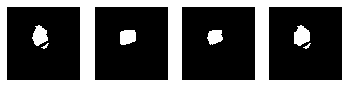

160 ============================
tp fp | 3977 4367
fn tn | 3004 250115
recall= 0.57
precision= 0.477
dice= 0.519
IoU= 0.3466399372439641


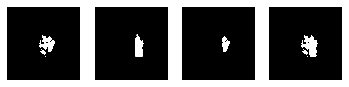

161 ============================
tp fp | 10566 30520
fn tn | 372 219669
recall= 0.966
precision= 0.257
dice= 0.406
IoU= 0.24953357107432161


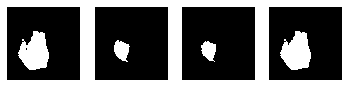

162 ============================
tp fp | 0 0
fn tn | 1007 260805
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


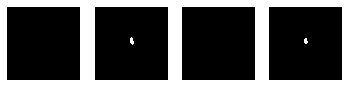

163 ============================
tp fp | 0 570
fn tn | 13752 246736
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


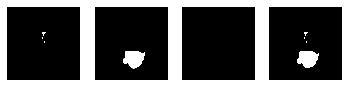

164 ============================
tp fp | 0 0
fn tn | 5644 255676
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


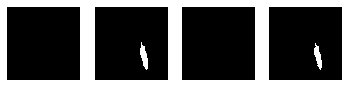

165 ============================
tp fp | 306 262
fn tn | 12478 247518
recall= 0.024
precision= 0.539
dice= 0.046
IoU= 0.0233587786259542


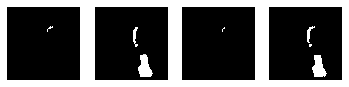

166 ============================
tp fp | 2677 3
fn tn | 15352 242471
recall= 0.148
precision= 0.999
dice= 0.259
IoU= 0.14833490330802904


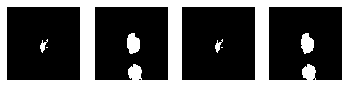

167 ============================
tp fp | 19971 7301
fn tn | 3506 230238
recall= 0.851
precision= 0.732
dice= 0.787
IoU= 0.6414530738099826


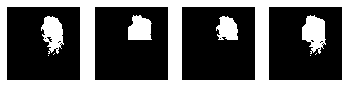

168 ============================
tp fp | 6157 12194
fn tn | 1567 241283
recall= 0.797
precision= 0.336
dice= 0.472
IoU= 0.30552798729654623


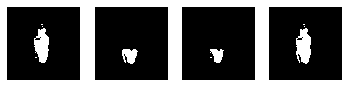

169 ============================
tp fp | 8104 20913
fn tn | 0 232372
recall= 1.0
precision= 0.279
dice= 0.437
IoU= 0.27220206905817546


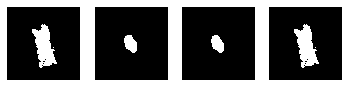

170 ============================
tp fp | 19098 13983
fn tn | 13727 213391
recall= 0.582
precision= 0.577
dice= 0.58
IoU= 0.40142088447956953


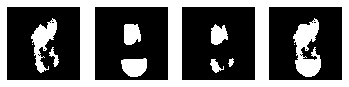

171 ============================
tp fp | 0 303
fn tn | 2071 259379
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


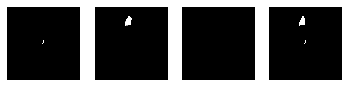

172 ============================
tp fp | 2065 8119
fn tn | 0 251584
recall= 1.0
precision= 0.203
dice= 0.337
IoU= 0.19554924242424243


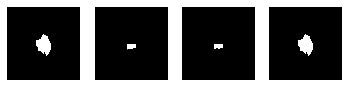

173 ============================
tp fp | 340 20
fn tn | 3387 257713
recall= 0.091
precision= 0.944
dice= 0.166
IoU= 0.09064249533457745


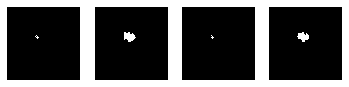

174 ============================
tp fp | 0 0
fn tn | 862 260979
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


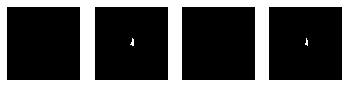

175 ============================
tp fp | 715 7466
fn tn | 339 253267
recall= 0.678
precision= 0.087
dice= 0.155
IoU= 0.08257304538630326


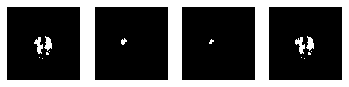

176 ============================
tp fp | 0 0
fn tn | 9505 251592
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


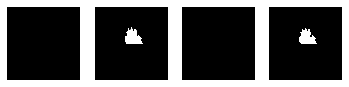

177 ============================
tp fp | 3425 22345
fn tn | 120 235732
recall= 0.966
precision= 0.133
dice= 0.234
IoU= 0.12988244216913158


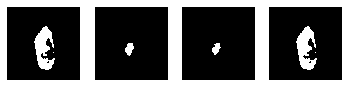

178 ============================
tp fp | 0 0
fn tn | 10416 250481
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


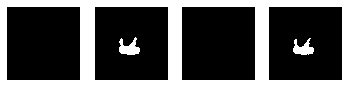

179 ============================
tp fp | 1460 16432
fn tn | 1943 241619
recall= 0.429
precision= 0.082
dice= 0.137
IoU= 0.07268020708880923


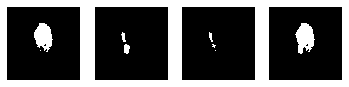

180 ============================
tp fp | 12915 42713
fn tn | 9418 195989
recall= 0.578
precision= 0.232
dice= 0.331
IoU= 0.19731112978382095


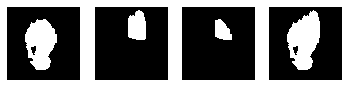

181 ============================
tp fp | 0 289
fn tn | 5552 255518
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


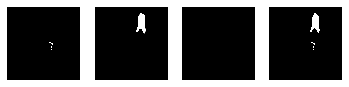

182 ============================
tp fp | 3662 30316
fn tn | 420 227147
recall= 0.897
precision= 0.108
dice= 0.192
IoU= 0.10537219808361868


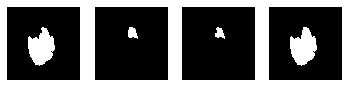

183 ============================
tp fp | 0 0
fn tn | 839 260973
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


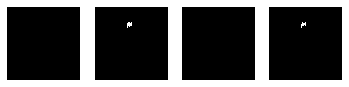

184 ============================
tp fp | 0 0
fn tn | 12204 249028
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


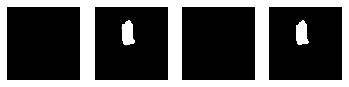

185 ============================
tp fp | 0 0
fn tn | 1419 260327
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


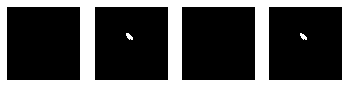

186 ============================
tp fp | 2840 1
fn tn | 24380 233072
recall= 0.104
precision= 1.0
dice= 0.189
IoU= 0.10428524216942679


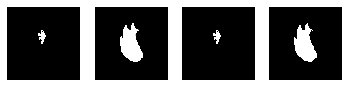

187 ============================
tp fp | 0 0
fn tn | 20680 240087
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


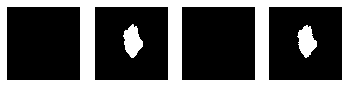

188 ============================
tp fp | 6052 34108
fn tn | 932 220030
recall= 0.867
precision= 0.151
dice= 0.257
IoU= 0.14489561386707528


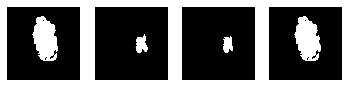

189 ============================
tp fp | 5549 3168
fn tn | 1257 251232
recall= 0.815
precision= 0.637
dice= 0.715
IoU= 0.5324824872852894


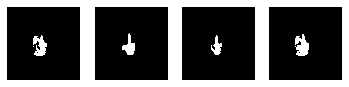

190 ============================
tp fp | 0 0
fn tn | 581 261363
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


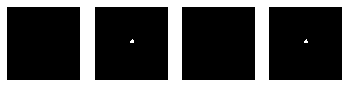

191 ============================
tp fp | 0 0
fn tn | 366 261585
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


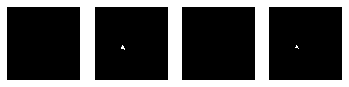

192 ============================
tp fp | 0 0
fn tn | 1687 259976
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


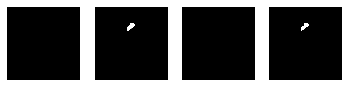

193 ============================
tp fp | 1370 2392
fn tn | 65 257934
recall= 0.955
precision= 0.364
dice= 0.527
IoU= 0.3419870194707938


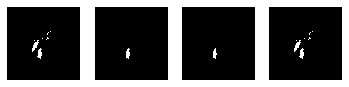

194 ============================
tp fp | 5858 8745
fn tn | 12516 233584
recall= 0.319
precision= 0.401
dice= 0.355
IoU= 0.21138094035290297


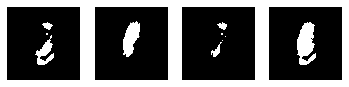

195 ============================
tp fp | 184 11348
fn tn | 5842 243960
recall= 0.031
precision= 0.016
dice= 0.021
IoU= 0.010546830218961366


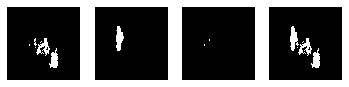

196 ============================
tp fp | 2744 72711
fn tn | 0 186226
recall= 1.0
precision= 0.036
dice= 0.07
IoU= 0.03614426091309044


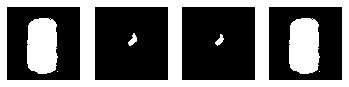

197 ============================
tp fp | 2197 392
fn tn | 9601 248676
recall= 0.186
precision= 0.849
dice= 0.305
IoU= 0.17749232509290677


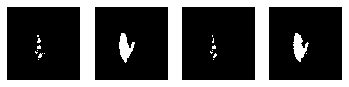

198 ============================
tp fp | 2 46
fn tn | 7987 253102
recall= 0.0
precision= 0.042
dice= 0.0
IoU= 0.0002489110143123833


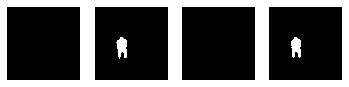

199 ============================
tp fp | 0 0
fn tn | 15052 245641
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


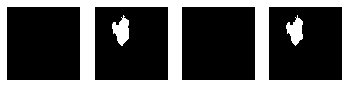

200 ============================
tp fp | 0 0
fn tn | 678 261135
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


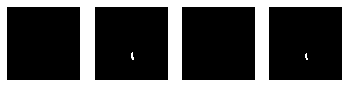

201 ============================
tp fp | 12818 1848
fn tn | 14474 231145
recall= 0.47
precision= 0.874
dice= 0.611
IoU= 0.436461454644511


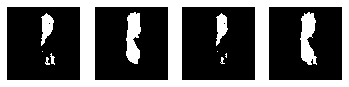

202 ============================
tp fp | 13075 19752
fn tn | 10 227990
recall= 0.999
precision= 0.398
dice= 0.57
IoU= 0.3833411516359798


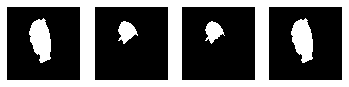

203 ============================
tp fp | 0 0
fn tn | 3791 257464
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


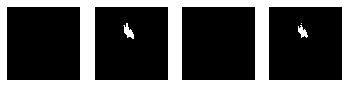

204 ============================
tp fp | 939 0
fn tn | 1750 259032
recall= 0.349
precision= 1.0
dice= 0.518
IoU= 0.34920044626255115


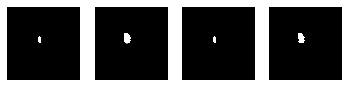

205 ============================
tp fp | 1370 2050
fn tn | 517 257666
recall= 0.726
precision= 0.401
dice= 0.516
IoU= 0.3352912383749388


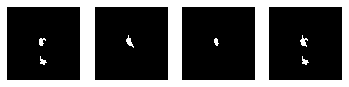

206 ============================
tp fp | 933 12422
fn tn | 12664 234142
recall= 0.069
precision= 0.07
dice= 0.069
IoU= 0.03537172536679683


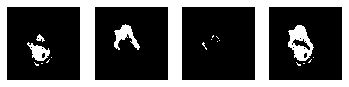

207 ============================
tp fp | 13843 830
fn tn | 11557 233984
recall= 0.545
precision= 0.943
dice= 0.691
IoU= 0.5190086982603479


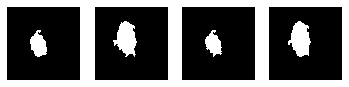

208 ============================
tp fp | 21878 12827
fn tn | 2154 223882
recall= 0.91
precision= 0.63
dice= 0.745
IoU= 0.5812742441149902


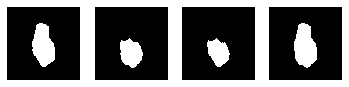

209 ============================
tp fp | 854 126
fn tn | 37020 222232
recall= 0.023
precision= 0.871
dice= 0.044
IoU= 0.022473684210526316


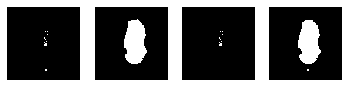

210 ============================
tp fp | 0 0
fn tn | 352 261528
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


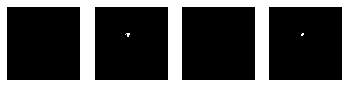

211 ============================
tp fp | 146 0
fn tn | 1543 259955
recall= 0.086
precision= 1.0
dice= 0.159
IoU= 0.08644168146832445


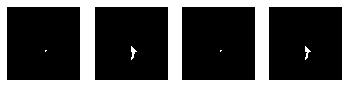

212 ============================
tp fp | 0 0
fn tn | 7779 253325
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


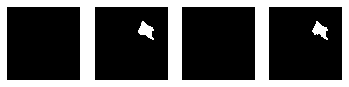

213 ============================
tp fp | 4163 37772
fn tn | 3513 215438
recall= 0.542
precision= 0.099
dice= 0.168
IoU= 0.09076637959228169


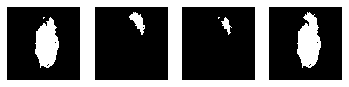

214 ============================
tp fp | 3048 46906
fn tn | 0 211700
recall= 1.0
precision= 0.061
dice= 0.115
IoU= 0.06042343985409563


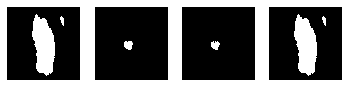

215 ============================
tp fp | 8408 0
fn tn | 62363 188798
recall= 0.119
precision= 1.0
dice= 0.212
IoU= 0.11880572550903619


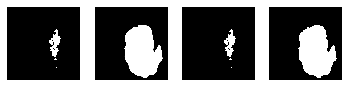

216 ============================
tp fp | 23075 32586
fn tn | 694 203868
recall= 0.971
precision= 0.415
dice= 0.581
IoU= 0.3989453665283541


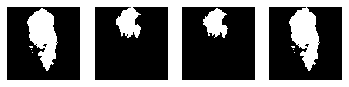

217 ============================
tp fp | 11 0
fn tn | 29962 230492
recall= 0.0
precision= 1.0
dice= 0.001
IoU= 0.00036699696393420743


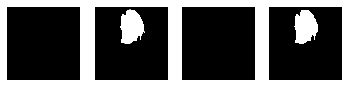

218 ============================
tp fp | 13605 2786
fn tn | 7354 236691
recall= 0.649
precision= 0.83
dice= 0.729
IoU= 0.5633773655223819


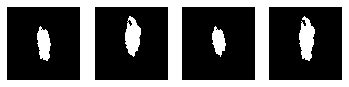

219 ============================
tp fp | 0 0
fn tn | 3039 258574
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


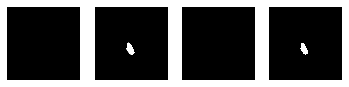

220 ============================
tp fp | 11825 28847
fn tn | 427 219489
recall= 0.965
precision= 0.291
dice= 0.447
IoU= 0.27935270493739667


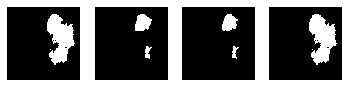

221 ============================
tp fp | 14928 63048
fn tn | 3917 178173
recall= 0.792
precision= 0.191
dice= 0.308
IoU= 0.1788598404064125


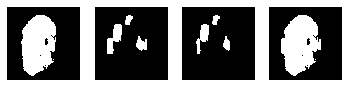

222 ============================
tp fp | 8251 1593
fn tn | 3013 248122
recall= 0.733
precision= 0.838
dice= 0.782
IoU= 0.6194444444444445


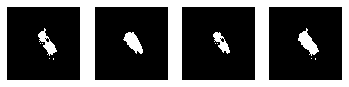

223 ============================
tp fp | 1707 5496
fn tn | 10840 242093
recall= 0.136
precision= 0.237
dice= 0.173
IoU= 0.09366769095697981


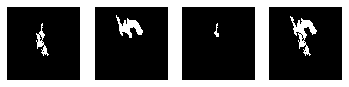

224 ============================
tp fp | 6080 24660
fn tn | 10185 219844
recall= 0.374
precision= 0.198
dice= 0.259
IoU= 0.14638256891778018


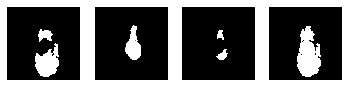

225 ============================
tp fp | 2665 1120
fn tn | 1997 255614
recall= 0.572
precision= 0.704
dice= 0.631
IoU= 0.44107911287653095


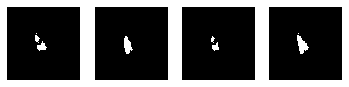

226 ============================
tp fp | 21155 7099
fn tn | 2524 229463
recall= 0.893
precision= 0.749
dice= 0.815
IoU= 0.6595068117342644


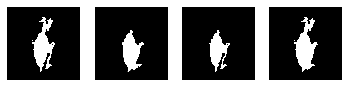

227 ============================
tp fp | 930 11554
fn tn | 188 249150
recall= 0.832
precision= 0.074
dice= 0.137
IoU= 0.07259953161592506


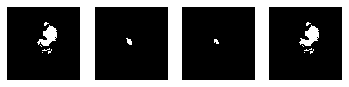

228 ============================
tp fp | 1487 46697
fn tn | 0 213429
recall= 1.0
precision= 0.031
dice= 0.06
IoU= 0.030524479113209484


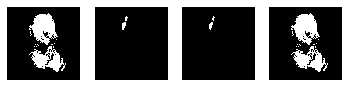

229 ============================
tp fp | 3287 36
fn tn | 11959 245544
recall= 0.216
precision= 0.989
dice= 0.354
IoU= 0.2150474321229964


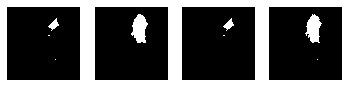

230 ============================
tp fp | 4665 664
fn tn | 4366 251180
recall= 0.517
precision= 0.875
dice= 0.65
IoU= 0.47738436348751534


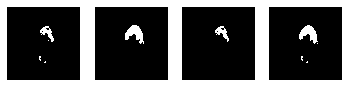

231 ============================
tp fp | 6876 4534
fn tn | 11598 237605
recall= 0.372
precision= 0.603
dice= 0.46
IoU= 0.2921978582355941


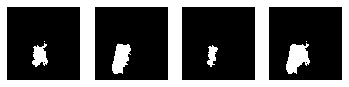

232 ============================
tp fp | 1786 7840
fn tn | 11262 239439
recall= 0.137
precision= 0.186
dice= 0.158
IoU= 0.0844125153606201


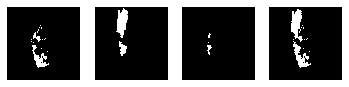

233 ============================
tp fp | 3636 24229
fn tn | 7 233179
recall= 0.998
precision= 0.13
dice= 0.231
IoU= 0.12560019344364226


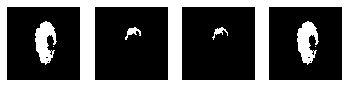

234 ============================
tp fp | 1951 45
fn tn | 1058 258443
recall= 0.648
precision= 0.977
dice= 0.78
IoU= 0.6221301020408163


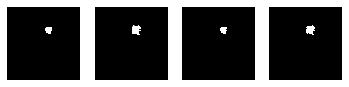

235 ============================
tp fp | 4869 23508
fn tn | 1656 231201
recall= 0.746
precision= 0.172
dice= 0.279
IoU= 0.15956610080618733


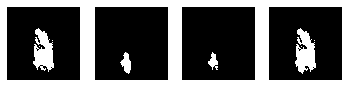

236 ============================
tp fp | 19631 483
fn tn | 6112 234296
recall= 0.763
precision= 0.976
dice= 0.856
IoU= 0.7394530661443424


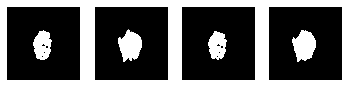

237 ============================
tp fp | 0 0
fn tn | 9374 251843
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


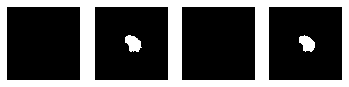

238 ============================
tp fp | 5127 9295
fn tn | 2711 243743
recall= 0.654
precision= 0.355
dice= 0.461
IoU= 0.2934073480599748


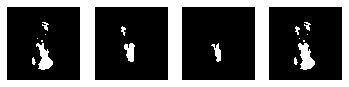

239 ============================
tp fp | 735 0
fn tn | 4595 255861
recall= 0.138
precision= 1.0
dice= 0.242
IoU= 0.13782111381961373


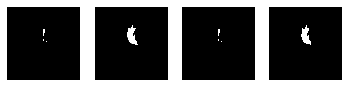

240 ============================
tp fp | 32438 31
fn tn | 22910 204676
recall= 0.586
precision= 0.999
dice= 0.739
IoU= 0.584637012472064


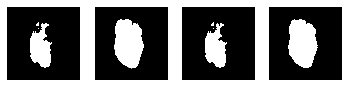

241 ============================
tp fp | 0 0
fn tn | 16091 244573
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


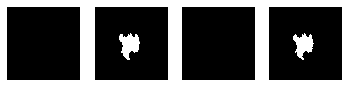

242 ============================
tp fp | 0 0
fn tn | 13915 246882
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


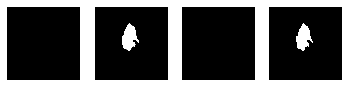

243 ============================
tp fp | 2315 805
fn tn | 2560 255812
recall= 0.475
precision= 0.742
dice= 0.579
IoU= 0.3967437874892888


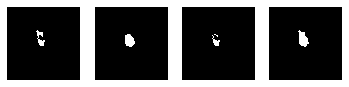

244 ============================
tp fp | 22728 868
fn tn | 1174 235872
recall= 0.951
precision= 0.963
dice= 0.957
IoU= 0.8855639976621859


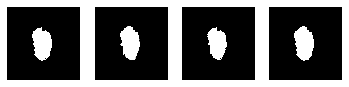

245 ============================
tp fp | 0 0
fn tn | 10719 249822
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


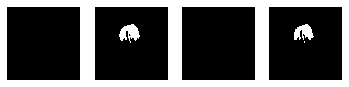

246 ============================
tp fp | 0 1499
fn tn | 9555 249908
recall= 0.0
precision= 0.0
dice= 0.0
IoU= 0.0


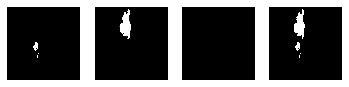

247 ============================
tp fp | 0 0
fn tn | 3887 257664
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


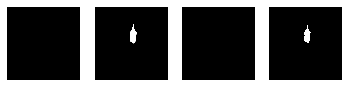

248 ============================
tp fp | 3097 53256
fn tn | 0 205258
recall= 1.0
precision= 0.055
dice= 0.104
IoU= 0.05444221776887107


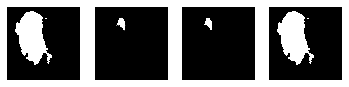

249 ============================
tp fp | 7056 17681
fn tn | 2500 233966
recall= 0.738
precision= 0.285
dice= 0.412
IoU= 0.2554485554992397


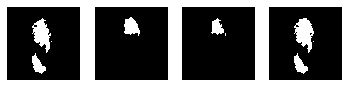

250 ============================
tp fp | 0 0
fn tn | 9934 251125
recall= 0.0
precision= nan
dice= 0.0
IoU= 0.0


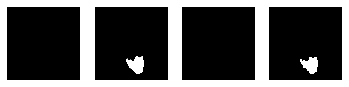

251 ============================
tp fp | 3328 7335
fn tn | 7091 243264
recall= 0.319
precision= 0.312
dice= 0.316
IoU= 0.18354290756673286


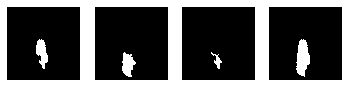

252 ============================
tp fp | 6668 37679
fn tn | 15011 200142
recall= 0.308
precision= 0.15
dice= 0.202
IoU= 0.11093365275836826


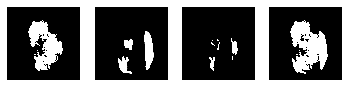

253 ============================
tp fp | 7700 14
fn tn | 13601 239297
recall= 0.361
precision= 0.998
dice= 0.531
IoU= 0.3601496725912067


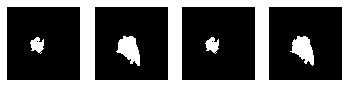

254 ============================
tp fp | 38868 6123
fn tn | 3617 209751
recall= 0.915
precision= 0.864
dice= 0.889
IoU= 0.7639000805801772


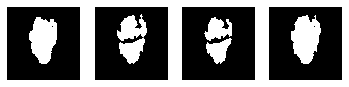

255 ============================
tp fp | 1601 24471
fn tn | 84 235575
recall= 0.95
precision= 0.061
dice= 0.115
IoU= 0.06036042829135877


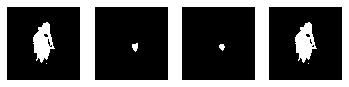

256 ============================
tp fp | 8905 19501
fn tn | 3412 228857
recall= 0.723
precision= 0.313
dice= 0.437
IoU= 0.27432919503404085


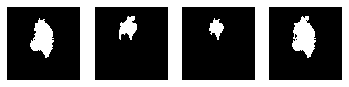

257 ============================
tp fp | 3977 1004
fn tn | 8833 246840
recall= 0.31
precision= 0.798
dice= 0.447
IoU= 0.28237716557796083


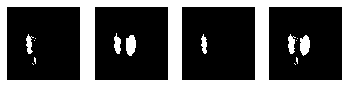

258 ============================
tp fp | 10717 19676
fn tn | 568 229660
recall= 0.95
precision= 0.353
dice= 0.514
IoU= 0.33359272863101536


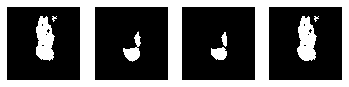

259 ============================
tp fp | 460 1161
fn tn | 12898 246473
recall= 0.034
precision= 0.284
dice= 0.061
IoU= 0.03168262277016323


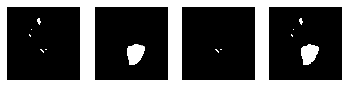

260 ============================
tp fp | 11263 75808
fn tn | 3032 170441
recall= 0.788
precision= 0.129
dice= 0.222
IoU= 0.12329231981784745


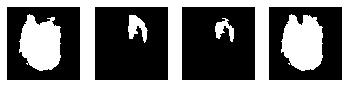

261 ============================
tp fp | 826 16910
fn tn | 330 243727
recall= 0.715
precision= 0.047
dice= 0.087
IoU= 0.045454545454545456


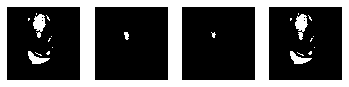

262 ============================
tp fp | 5582 49881
fn tn | 626 205207
recall= 0.899
precision= 0.101
dice= 0.181
IoU= 0.09822449805557022


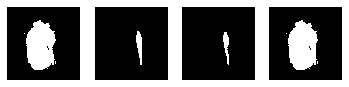

263 ============================
tp fp | 3882 0
fn tn | 67400 188642
recall= 0.054
precision= 1.0
dice= 0.103
IoU= 0.0544597514098931


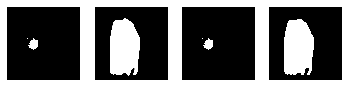

264 ============================
tp fp | 4680 33259
fn tn | 0 223209
recall= 1.0
precision= 0.123
dice= 0.22
IoU= 0.12020033388981637


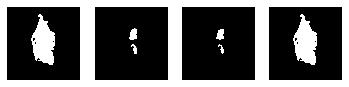

265 ============================
tp fp | 3515 6527
fn tn | 6693 243571
recall= 0.344
precision= 0.35
dice= 0.347
IoU= 0.2026988062972147


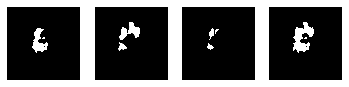

266 ============================
tp fp | 360 18005
fn tn | 341 243063
recall= 0.514
precision= 0.02
dice= 0.038
IoU= 0.019084981180088004


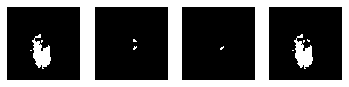

267 ============================
tp fp | 18860 343
fn tn | 13116 228063
recall= 0.59
precision= 0.982
dice= 0.737
IoU= 0.5758954471892271


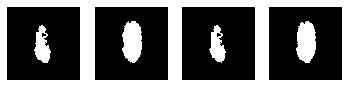

268 ============================
tp fp | 1928 2177
fn tn | 22 257560
recall= 0.989
precision= 0.47
dice= 0.637
IoU= 0.4278739458499778


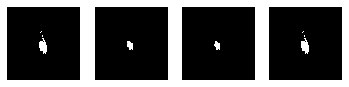

269 ============================
tp fp | 5522 46250
fn tn | 484 208749
recall= 0.919
precision= 0.107
dice= 0.191
IoU= 0.10389463781749765


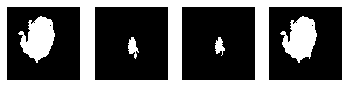

270 ============================
tp fp | 5653 1908
fn tn | 4062 249374
recall= 0.582
precision= 0.748
dice= 0.654
IoU= 0.47108333333333335


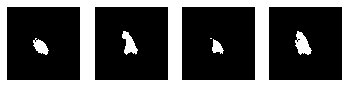

271 ============================
tp fp | 34935 3065
fn tn | 9137 212873
recall= 0.793
precision= 0.919
dice= 0.851
IoU= 0.7352879272604815


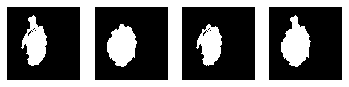

In [131]:
recall_list = []
# specificity_list = []
precision_list=[]
# acc_list = []
dice_list = []
IoU_list=[]

for i in range(test_label.shape[0]):
    
    seg1 = preds_imgs[i,:,:,0]
    gt1 = test_label[i,:,:,0]
    
    seg1_n = seg1 == 0
    seg1_t = seg1 == 1

    gt1_n = gt1 == 0
    gt1_t = gt1 == 1


    tp = np.sum(seg1_t&gt1_t)

    fp = np.sum(seg1_t&gt1_n)

    tn = np.sum(seg1_n&gt1_n)

    fn = np.sum(gt1_t&seg1_n)


    recall = tp / (tp + fn)
    recall_list.append(recall)

    precision= tp/(tp+fp)
    precision_list.append(precision)
    
    
    #specificity = tn / (tn+fp)
    #specificity_list.append(specificity)

    #acc = (tp + tn) / (tp + tn + fp + fn)
    #acc_list.append(acc)


    dice = (2*tp) / (2*tp + fp + fn)
    dice_list.append(dice)
    
    
    
    print(i,'============================')
    print('tp fp |', tp, fp)
    print('fn tn |', fn, tn)
    print('recall=',round(recall,3))
    print('precision=',round(precision,3))
    #print('specificity=',round(specificity,3))
    #print('acc=',round(acc,3))
    print('dice=',round(dice,3))
        
    tp_cp=np.zeros(seg1_t.shape)
    tp_cp[seg1_t&gt1_t==False]=0
    tp_cp[seg1_t&gt1_t==True]=1
    
    union=np.zeros(seg1_t.shape)
    union[seg1_t|gt1_t==False]=0
    union[seg1_t|gt1_t==True]=1
    
    
    IoU = (np.sum(tp_cp))/(np.sum(union))
    IoU_list.append(IoU)
    print('IoU=',IoU)
    
    
#     plt.subplot(1,4,1)
#     plt.imshow(preds_imgs[i,:,:,0],cmap='gray')
#     plt.axis('off')
#     plt.subplot(1,4,2)
#     plt.imshow(test_label[i])
#     plt.axis('off')
#     plt.subplot(1,4,3)
#     plt.imshow(tp_cp,cmap='gray')
#     plt.axis('off')
#     plt.subplot(1,4,4)
#     plt.imshow(union,cmap='gray')
#     plt.axis('off')
#     plt.show()
    

In [149]:
dice_list = np.array(dice_list)
recall_list = np.array(recall_list)
precision_list = np.array(precision_list)
IoU_list = np.array(IoU_list)



dice_list = dice_list[~np.isnan(dice_list)]
recall_list = recall_list[~np.isnan(recall_list)]
precision_list = precision_list[~np.isnan(precision_list)]
IoU_list = IoU_list[~np.isnan(IoU_list)]


print('Sensitivity : ', np.mean(recall_list))
print('precision : ', np.mean(precision_list))
print('IoU : ', np.mean(IoU_list))
print('DSC : ', np.mean(dice_list))



print('Sensitivity : ', np.std(recall_list))
print('precision : ', np.std(precision_list))
print('IoU : ', np.std(IoU_list))
print('DSC : ', np.std(dice_list))

Sensitivity :  0.45341219634486984
precision :  0.44732728697946367
IoU :  0.20061242706010862
DSC :  0.2905318468303732
Sensitivity :  0.39434325676357673
precision :  0.3505375684649676
IoU :  0.2171267132665917
DSC :  0.2755537090572629
